This tutorial processes C. elegans embryogenesis single cell data published by [Packer & Zhu et al., 2019](https://doi.org/10.1126/science.aax1971). Data can be downloaded from https://zenodo.org/records/15236812.

In [1]:
%load_ext autoreload
%autoreload 2

### Load package and data

In [2]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/celegans_data/') # Replace with your data directory
data_path = data_dir / "celegans_global_adata.h5ad"
adata = sc.read(data_path)

In [3]:
proj_name = "concord_celegans"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [4]:
adata.layers["counts"] = adata.X.copy() # Store raw counts in a layer, because adata.X can be modified
adata = adata[adata.obs['to.filter'] == 'FALSE'] # Only keep cells that pass quality filter

### Run Concord

In [17]:
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'domain_key': 'batch', # **Must specify if you want to perform batch correction**
        "latent_dim": 300,
        "batch_size": 256,
        "encoder_dims": [1000],
        "p_intra_domain": 1.0,
        "p_intra_knn": 0.0,
        "clr_beta": 1.0,
        "element_mask_prob": 0.40,
        "feature_mask_prob": 0.20,
        "clr_temperature": 0.30,
        "sampler_knn": 1000,
        "n_epochs": 15,        # 10-15 epochs is usually enough for convergence, here for consistence with hyperparameter benchmarking
        'verbose': True, # Verbosity level, set to True for more detailed output
        'seed': seed, # random seed for reproducibility
        'preload_dense': True, # Whether to load data into memory, set to False if memory is a concern
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...


In [18]:
output_key = 'concord_hcl'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.fit_transform(output_key=output_key) # Result saved to ccd.adata.obsm[output_key]

concord - INFO - Operating directly on the provided AnnData object. Object may be modified.
concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - INFO - Using NT-Xent loss with beta=1.0. This will apply hard-negative weighting to the contrastive loss.
concord - INFO - HCL (Contrastive learning with hard negative samples) mode is enabled.
concord - INFO - Column 'batch' is already of type: category
concord - INFO - Unused levels dropped for column 'batch'.
concord - INFO - Encoder input dim: 10000
concord - INFO - Model loaded to device: cpu
concord - INFO - Total number of parameters: 10303956
concord.model.dataloader - INFO - Using 0 DataLoader workers.
concord.model.dataloader - INFO - Filtering features with provided list (10000 features)...
concord.model.anndataset - INFO - Initialized lightweight dataset with 89701 samples.
concord.model.datal

Epoch 0 Training: 100%|██████████| 348/348 [00:11<00:00, 29.15it/s, loss=4.652]

concord - INFO - Epoch   0 | Train Loss: 4.94, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.94, IMPORTANCE: 0.00
concord - INFO - Starting epoch 2/15
concord - INFO - Processing chunk 1/1 for epoch 2
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 1 Training: 100%|██████████| 348/348 [00:12<00:00, 27.77it/s, loss=4.398]

concord - INFO - Epoch   1 | Train Loss: 4.51, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.51, IMPORTANCE: 0.00
concord - INFO - Starting epoch 3/15
concord - INFO - Processing chunk 1/1 for epoch 3
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 2 Training: 100%|██████████| 348/348 [00:11<00:00, 29.41it/s, loss=4.265]

concord - INFO - Epoch   2 | Train Loss: 4.34, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.34, IMPORTANCE: 0.00


concord - INFO - Starting epoch 4/15
concord - INFO - Processing chunk 1/1 for epoch 4
concord - INFO - Number of samples in train_dataloader: 89701


Epoch 3 Training: 100%|██████████| 348/348 [00:11<00:00, 29.44it/s, loss=4.219]

concord - INFO - Epoch   3 | Train Loss: 4.25, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.25, IMPORTANCE: 0.00
concord - INFO - Starting epoch 5/15
concord - INFO - Processing chunk 1/1 for epoch 5
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 4 Training: 100%|██████████| 348/348 [00:11<00:00, 30.26it/s, loss=4.089]

concord - INFO - Epoch   4 | Train Loss: 4.19, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.19, IMPORTANCE: 0.00
concord - INFO - Starting epoch 6/15
concord - INFO - Processing chunk 1/1 for epoch 6
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 5 Training: 100%|██████████| 348/348 [00:11<00:00, 30.58it/s, loss=4.050]

concord - INFO - Epoch   5 | Train Loss: 4.13, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.13, IMPORTANCE: 0.00
concord - INFO - Starting epoch 7/15
concord - INFO - Processing chunk 1/1 for epoch 7
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 6 Training: 100%|██████████| 348/348 [00:11<00:00, 30.07it/s, loss=3.998]

concord - INFO - Epoch   6 | Train Loss: 4.09, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.09, IMPORTANCE: 0.00
concord - INFO - Starting epoch 8/15
concord - INFO - Processing chunk 1/1 for epoch 8
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 7 Training: 100%|██████████| 348/348 [00:11<00:00, 30.10it/s, loss=4.077]

concord - INFO - Epoch   7 | Train Loss: 4.06, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.06, IMPORTANCE: 0.00
concord - INFO - Starting epoch 9/15
concord - INFO - Processing chunk 1/1 for epoch 9
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 8 Training: 100%|██████████| 348/348 [00:11<00:00, 29.19it/s, loss=3.953]

concord - INFO - Epoch   8 | Train Loss: 4.03, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.03, IMPORTANCE: 0.00
concord - INFO - Starting epoch 10/15
concord - INFO - Processing chunk 1/1 for epoch 10
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 9 Training: 100%|██████████| 348/348 [00:12<00:00, 28.97it/s, loss=3.925]

concord - INFO - Epoch   9 | Train Loss: 4.00, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.00, IMPORTANCE: 0.00
concord - INFO - Starting epoch 11/15
concord - INFO - Processing chunk 1/1 for epoch 11
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 10 Training: 100%|██████████| 348/348 [00:11<00:00, 29.32it/s, loss=3.984]

concord - INFO - Epoch  10 | Train Loss: 3.98, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.98, IMPORTANCE: 0.00
concord - INFO - Starting epoch 12/15
concord - INFO - Processing chunk 1/1 for epoch 12
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 11 Training: 100%|██████████| 348/348 [00:11<00:00, 30.72it/s, loss=3.903]

concord - INFO - Epoch  11 | Train Loss: 3.96, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.96, IMPORTANCE: 0.00
concord - INFO - Starting epoch 13/15
concord - INFO - Processing chunk 1/1 for epoch 13
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 12 Training: 100%|██████████| 348/348 [00:11<00:00, 30.65it/s, loss=3.995]

concord - INFO - Epoch  12 | Train Loss: 3.95, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.95, IMPORTANCE: 0.00
concord - INFO - Starting epoch 14/15
concord - INFO - Processing chunk 1/1 for epoch 14
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 13 Training: 100%|██████████| 348/348 [00:11<00:00, 30.79it/s, loss=3.905]

concord - INFO - Epoch  13 | Train Loss: 3.93, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.93, IMPORTANCE: 0.00
concord - INFO - Starting epoch 15/15
concord - INFO - Processing chunk 1/1 for epoch 15
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 14 Training: 100%|██████████| 348/348 [00:11<00:00, 30.74it/s, loss=3.921]

concord - INFO - Epoch  14 | Train Loss: 3.91, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.91, IMPORTANCE: 0.00


concord - INFO - Model saved to ../save/concord_celegans-Jul30/final_model_Jul30-1938.pt
concord - INFO - Final model saved at: ../save/concord_celegans-Jul30/final_model_Jul30-1938.pt; Configuration saved at: ../save/concord_celegans-Jul30/config_Jul30-1938.json.
concord.model.dataloader - INFO - Using 0 DataLoader workers.
concord.model.dataloader - INFO - Filtering features with provided list (10000 features)...
concord.model.anndataset - INFO - Initialized lightweight dataset with 89701 samples.
concord.model.dataloader - INFO - Loading all data into memory for fast access. This may consume a lot of RAM. If you run out of memory, please set `preload_dense=False`.
concord - INFO - Predicting for chunk 1/1
concord - INFO - Predictions added to AnnData object with base key 'concord_hcl'.


### Visualization

We recommend using UMAP to visualize the CONCORD latent space:

concord - INFO - UMAP embedding stored in adata.obsm['concord_hcl_UMAP']


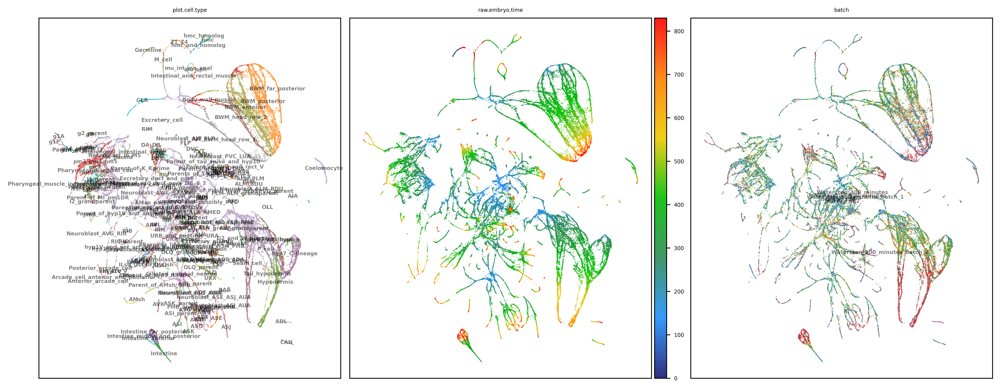

In [19]:
basis = 'concord_hcl'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['plot.cell.type', 'raw.embryo.time', "batch"]
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = pal,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [20]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal[col],
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000
        )

concord - INFO - UMAP embedding stored in adata.obsm['concord_hcl_UMAP_3D']
concord.plotting.pl_embedding - INFO - 3D plot saved to ../save/concord_celegans-Jul30/concord_hcl_UMAP_3D_plot.cell.type_Jul30-1907_plot.cell.type.html


concord.plotting.pl_embedding - INFO - 3D plot saved to ../save/concord_celegans-Jul30/concord_hcl_UMAP_3D_raw.embryo.time_Jul30-1907_raw.embryo.time.html


concord.plotting.pl_embedding - INFO - 3D plot saved to ../save/concord_celegans-Jul30/concord_hcl_UMAP_3D_batch_Jul30-1907_batch.html


In [21]:
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad") # Save the adata object with the encoded embeddings
print(f"Saved adata to {data_dir / f'{proj_name}_{file_suffix}.h5ad'}")

Saved adata to ../data/celegans_data/concord_celegans_Jul30-1907.h5ad


concord.plotting.pl_embedding - INFO - Plotting 3D: concord_hcl, color by embryo.time, basis: UMAP_3D
palette_dict None
color_by embryo.time
pal BlueGreenRed
cmap <matplotlib.colors.LinearSegmentedColormap object at 0x37a50af60>


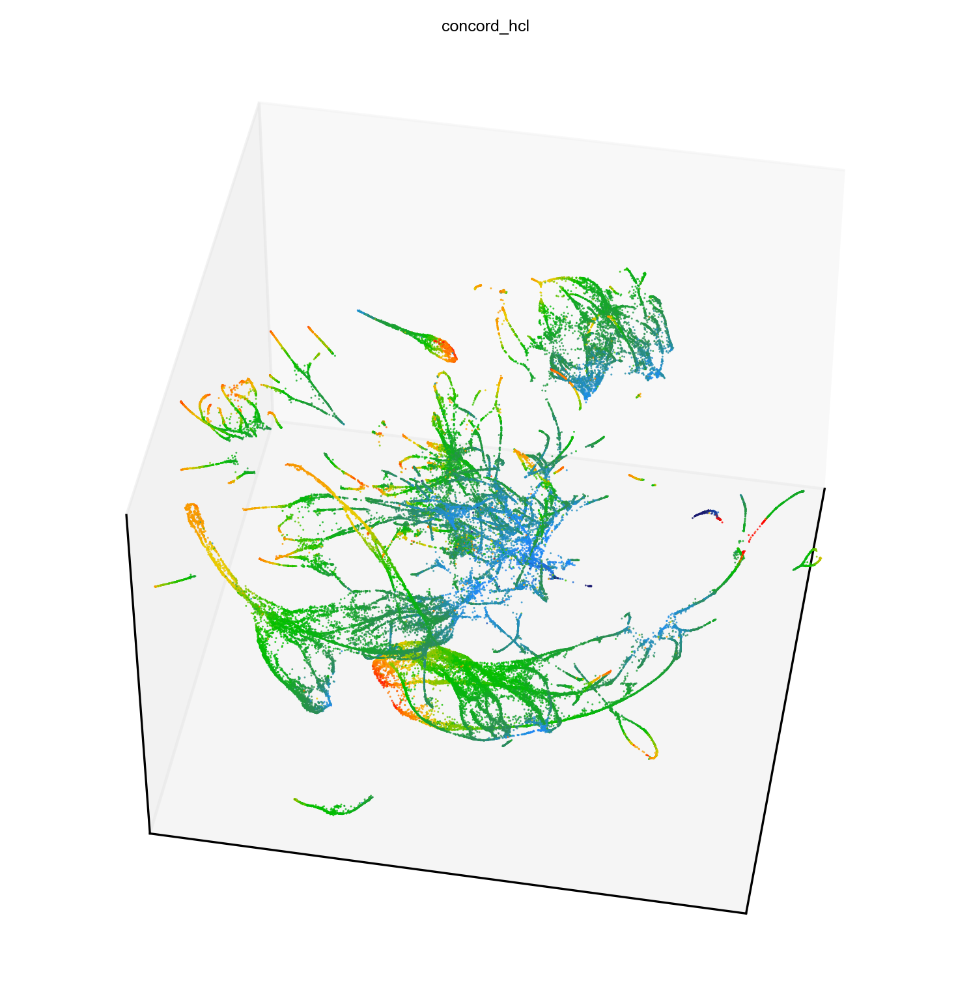

concord.plotting.pl_embedding - INFO - Saved multi-panel 3D figure: ../save/concord_celegans-Jul30/all_latent_3D_embryo.time_UMAP_3D_Jul30-1947_azim190_elev45.pdf


In [15]:
# Plot fixed 3D view
adata = sc.read(data_dir / f"concord_celegans_Jul30-1907.h5ad")
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
import matplotlib.pyplot as plt
import concord as ccd
custom_rc = {
    'font.family': 'Arial',  # Set the desired font for this plot
}
concord_keys = ['concord_hcl']
# azims = [30, 60, 90, 120, 150, 180, 210, 240, 270, 300, 330]
# elevs = [30, 45, 60]
azims = [190]
elevs = [45]
show_cols = ['embryo.time']
for azim in azims:
    for elev in elevs:
        with plt.rc_context(rc=custom_rc):
            ccd.pl.plot_all_embeddings_3d(
                adata=adata,
                combined_keys=concord_keys,         # or however you name your embeddings
                color_bys=show_cols,  # columns or gene names to color by
                basis_types=['UMAP_3D'],              # or whatever naming convention is in adata.obsm
                pal='BlueGreenRed',    
                ncols=2,
                rasterized=True,                   # Points get rasterized
                point_size=2,
                alpha=0.8,
                elev=elev,
                azim=azim,
                zoom_factor=0.05,
                show_grid=True,
                show_axis_labels=False,            # Turn off axis labels
                show_ticks=False,                  # No ticks
                show_legend=False,
                tick_label_font_size=6,
                legend_font_size=6,
                save_dir=save_dir,
                file_suffix=file_suffix + f'_azim{azim}_elev{elev}',
                save_format='pdf',
            )